## Embarassingly simple with ConvNexts, flattened

In [1]:
import anndata
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
from torchvision.transforms import RandomCrop, Compose, RandomRotation, Lambda
from torchvision.transforms.functional import crop

from torch.utils.data import DataLoader
from tqdm import tqdm

# from functools import partial
from typing import Optional, Tuple, Type, Dict, List

from utils import DatasetFromTIFF, plot_markers, get_marker_names_map

In [2]:
import json

marker_map = json.load(open('tokenizer_vocab.json'))
markers_names_map = {v: k for k, v in marker_map.items()}

In [3]:
class LayerNorm2d(nn.Module):
    """Layer normalization for 2D data from 
    https://github.com/facebookresearch/segment-anything/blob/main/segment_anything/modeling/common.py"""
    def __init__(self, num_channels: int, eps: float = 1e-6) -> None:
        super().__init__()
        self.weight = nn.Parameter(torch.ones(num_channels))
        self.bias = nn.Parameter(torch.zeros(num_channels))
        self.eps = eps

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        u = x.mean(1, keepdim=True)
        s = (x - u).pow(2).mean(1, keepdim=True)
        x = (x - u) / torch.sqrt(s + self.eps)
        x = self.weight[:, None, None] * x + self.bias[:, None, None]
        return x


class GlobalResponseNormalization(nn.Module):
    """Global Response Normalization (GRN) layer 
    from https://arxiv.org/pdf/2301.00808"""

    def __init__(self, dim, eps: float = 1e-6):
        super().__init__()
        self.eps = eps

        self.gamma = nn.Parameter(torch.zeros(1, 1, 1, dim))
        self.beta = nn.Parameter(torch.zeros(1, 1, 1, dim))

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # B, H, W, E = x.shape

        gx = torch.norm(x, p=2, dim=(1,2), keepdim=True)
        nx = gx / (gx.mean(dim=-1, keepdim=True) + self.eps)
        return self.gamma * (x * nx) + self.beta + x


class ConvNextBlock(nn.Module):
    """ConvNext2 block"""
    def __init__(
            self,
            dim: int,
            inter_dim: int,
    ):
            super().__init__()
            self.conv1 = nn.Conv2d(dim, dim, kernel_size=7, padding=3, groups=dim)
            self.ln = nn.LayerNorm(dim)
            self.conv2 = nn.Linear(dim, inter_dim) # equivalent to nn.Conv2d(dim, inter_dim, kernel_size=1)
            self.act = nn.GELU()
            self.grn = GlobalResponseNormalization(inter_dim)
            self.conv3 = nn.Linear(inter_dim, dim) # equivalent to nn.Conv2d(inter_dim, dim, kernel_size=1)

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # B, C, H, W = x.shape
        residual = x
        x = self.conv1(x)
        x = x.permute(0, 2, 3, 1)  # [B, H, W, C]
        x = self.ln(x)
        x = self.conv2(x)
        x = self.act(x)
        x = self.grn(x)
        x = self.conv3(x)
        x = x.permute(0, 3, 1, 2) # [B, C, H, W]
        x = x + residual

        return x


class ConvNextBlocks(nn.Module):
    """Spatial convolutional blocks (per channel/marker)"""

    def __init__(
        self,
        embedding_dim: int,
        num_blocks: int = 1,
    ) -> None:
        """
        Args:
            dim (int): Number of input channels.
            num_blocks (int): Number of spatial convolutional blocks.
        """
        super().__init__()

        self.spatial_conv_blocks = nn.ModuleList()
        for _ in range(num_blocks):
            self.spatial_conv_blocks.append(
                ConvNextBlock(
                    dim=embedding_dim,
                    inter_dim=embedding_dim*4,
                )
            )
        

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # B, C, H, W  = x.shape

        # Spatial convolutional blocks
        for block in self.spatial_conv_blocks:
            x = block(x)

        return x
    

class MultiplexImageEncoder(nn.Module):
    """Multiplex Image encoder integrating spatial and cross-channel blocks."""

    def __init__(
        self,
        layers_blocks: List[int],
        embedding_dims: List[int],
        channel_embedding_dim: int,
        num_channels: int,
        latent_dim: int,
        input_shape: Tuple[int, int] = (128, 128)
    ) -> None:
        """
        Args:
            layers_blocks (List[int]): Number of attention blocks in each layer.
            embedding_dims (List[int]): Number of input channels in each layer.
            channel_embedding_dim (int): Embedding dimension per channel pixel.
            num_channels (int): Maximal number of channels/markers (vocab dim).
            latent_dim (int): Dimensionality of latent vector.
            input_shape (Tuple[int, int]): Input image shape (H x W).
        """
        super().__init__()
        self.channel_embedder = nn.Embedding(num_channels, channel_embedding_dim)
        self.init_norm = nn.BatchNorm2d(channel_embedding_dim)

        # self.stem = nn.Conv2d(channel_embedding_dim, embedding_dims[0], kernel_size=4, padding=0, stride=4)
        self.poolings = nn.ModuleList()
        self.poolings.append(nn.Sequential(
            nn.MaxPool2d(kernel_size=2, stride=2),
            nn.Conv2d(channel_embedding_dim, embedding_dims[0], kernel_size=3, padding=1, stride=1),
        ))
        for i, out_dim in enumerate(embedding_dims[1:]):
            input_dim = embedding_dims[i]
            self.poolings.append(nn.Sequential(
                nn.MaxPool2d(kernel_size=2, stride=2),
                nn.Conv2d(input_dim, out_dim, kernel_size=3, padding=1, stride=1),
                
            ))


        self.norms = nn.ModuleList()
        for dim in embedding_dims:
            self.norms.append(nn.BatchNorm2d(dim))

        self.act = nn.GELU()
             
        self.blocks = nn.ModuleList()
        for blocks, dim in zip(layers_blocks, embedding_dims):
            self.blocks.append(
                ConvNextBlocks(
                    num_blocks=blocks,
                    embedding_dim=dim,
                )
            )
        
        compression_factor = 2**(-len(layers_blocks))
        last_featmap_size = (input_shape[0] * compression_factor, input_shape[1] * compression_factor)
        flattened_last_dim = int(last_featmap_size[0] * last_featmap_size[1] * embedding_dims[-1])
        self.latent_proj = nn.Linear(flattened_last_dim, latent_dim)
        # self.latent_norm = nn.LayerNorm(latent_dim)
        

    def forward(self, x: torch.Tensor, channel_ids: torch.Tensor) -> torch.Tensor:
        """Forward pass of the Multiplex Image Transformer.

        Args:
            x (torch.Tensor): Multiplex images batch tensor with shape [B, C, H, W]
            channel_ids (torch.Tensor): Channel ids tensor with shape [B, C]

        Returns:
            torch.Tensor: Embedding tensor
        """
        channel_embeds = self.channel_embedder(channel_ids) # [B, C, E]

        x = torch.einsum('bchw, bce -> behw', x, channel_embeds) # [B, E, H, W]
        x = self.init_norm(x)

        # poolings and blocks
        for pooling, norm, block in zip(self.poolings, self.norms, self.blocks):
            x = pooling(x)
            x = norm(x)
            x = self.act(x)
            x = block(x)
        
        # latent projection
        x = x.flatten(start_dim=1)
        x = self.latent_proj(x)
        # x = self.latent_norm(x)

        return x


class MultiplexImageDecoder(nn.Module):
    """Multiplex Image decoder integrating spatial and cross-channel blocks."""

    def __init__(
        self,
        layers_blocks: List[int],
        embedding_dims: List[int],
        channel_embedding_dim: int,
        num_channels: int,
        latent_dim: int,
        input_shape: Tuple[int, int] = (128, 128)
    ) -> None:
        """
        Args:
            layers_blocks (List[int]): Number of attention blocks in each layer.
            embedding_dims (List[int]): Number of input channels in each layer.
            channel_embedding_dim (int): Embedding dimension per channel pixel.
            num_channels (int): Maximal number of channels/markers (vocab dim).
            latent_dim (int): Dimensionality of latent vector.
            input_shape (Tuple[int, int]): Input image shape (H x W).
        """
        super().__init__()
        compression_factor = 2**(-len(layers_blocks))
        self.first_featmap_size = (int(input_shape[0] * compression_factor), int(input_shape[1] * compression_factor))
        flattened_first_dim = self.first_featmap_size[0] * self.first_featmap_size[1] * embedding_dims[0]

        self.latent_proj = nn.Linear(latent_dim, flattened_first_dim)
        self.unflatten = nn.Unflatten(1, (embedding_dims[0], *self.first_featmap_size))

        self.upsample = nn.Upsample(scale_factor=2, mode='bilinear')
        self.convs = nn.ModuleList()
        for i, dim in enumerate(embedding_dims[1:]):
            input_dim = embedding_dims[i]
            self.convs.append(
                nn.Conv2d(input_dim, dim, kernel_size=3, padding=1)
            )
        self.convs.append(
            nn.Conv2d(dim, channel_embedding_dim, kernel_size=3, padding=1)
        )

        self.act = nn.GELU()
             
        self.blocks = nn.ModuleList()
        for blocks, dim in zip(layers_blocks, embedding_dims):
            self.blocks.append(
                ConvNextBlocks(
                    num_blocks=blocks,
                    embedding_dim=dim,
                )
            )

        self.channel_embedder = nn.Embedding(num_channels, channel_embedding_dim)
        

    def forward(self, x: torch.Tensor, channel_ids: torch.Tensor) -> torch.Tensor:
        """Forward pass of the Multiplex Image Transformer.

        Args:
            x (torch.Tensor): Latent tensor of shape [B, E_latent]
            channel_ids (torch.Tensor): Channel ids tensor with shape [B, C]

        Returns:
            torch.Tensor: Embedding tensor
        """
        x = self.latent_proj(x) # [B, E_latent*H*W]
        x = self.act(x)
        x = self.unflatten(x) # [B, E_latent, H, W]
        
        # upsampling and blocks
        for conv, block in zip(self.convs, self.blocks):
            x = block(x)
            x = self.act(conv(self.upsample(x)))

        channel_embeds = self.channel_embedder(channel_ids)
        x = torch.einsum('behw, bce -> bchw', x, channel_embeds) # [B, C, H, W]

        return x



class MultiplexImageDecoderFCMAE(nn.Module):
    """Decoder for MIT model restoring the original image shape, inspired by the one from FCMAE
    (see https://github.com/facebookresearch/ConvNeXt-V2/blob/main/models/fcmae.py)"""
    
    def __init__(
            self,
            input_embedding_dim: int,
            decoded_embed_dim: int,
            num_blocks: int,
            scaling_factor: int,
            output_channels: int,
            input_shape: Tuple[int, int] = (128, 128)
        ) -> None:
            """
            Args:
                input_embedding_dim (int): Embedding dimension of the input tensor.
                decoded_embed_dim (int): Embedding dimension of the decoded tensor (before last projections).
                num_blocks (int): Number of multiplex blocks in each intermediate layer.
                scaling_factor (int): Scaling factor for the upsampling.
                output_channels (int): Number of output channels/markers.
                input_shape (Tuple[int, int]): Input image shape (H x W).
            """
            super().__init__()
            self.scaling_factor = scaling_factor
            self.output_channels = output_channels
            self.decoded_embed_dim = decoded_embed_dim

            self.first_input_shape = (int(input_shape[0] / scaling_factor), int(input_shape[1] / scaling_factor))

            # input projection
            self.proj = nn.Linear(
                input_embedding_dim, 
                output_channels * decoded_embed_dim * self.first_input_shape[0] * self.first_input_shape[1]
            )

            self.unflatten = nn.Unflatten(1, (output_channels, decoded_embed_dim, *self.first_input_shape))

            self.decoder = ConvNextBlocks(
                num_blocks=num_blocks,
                embedding_dim=decoded_embed_dim,
            )

            self.pred = nn.Conv2d(decoded_embed_dim, scaling_factor**2, 1)

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        """Forward pass of the Multiplex Image Decoder.

        Args:
            x (torch.Tensor): Input tensor (embedding).

        Returns:
            torch.Tensor: Reconstructed image tensor
        """
        H, W = self.first_input_shape
        B, _ = x.shape
        C, E, A = self.output_channels, self.decoded_embed_dim, self.scaling_factor

        x = self.proj(x) # [B, C*E*H*W]
        x = self.unflatten(x) # [B, C, E, H, W]
        x = x.reshape(B*C, E, H, W) # decoder per channel
        x = self.decoder(x)
        x = self.pred(x)

        x = x.reshape(B, C, A, A, H, W)
        x = torch.einsum('bcxyhw -> bchxwy', x)
        x = x.reshape(B, C, H*A, W*A)

        return x
    


class MultiplexImageTransformer(nn.Module):
    """Multiplex Image Transformer model combining encoder and decoder."""

    def __init__(
        self,
        num_channels: int,
        channel_embedding_dim: int,
        encoder_layers_blocks: List[int],
        encoder_embedding_dims: List[int],
        latent_dim: int,
        decoder_layer_blocks: List[int],
        decoder_embedding_dims: List[int],
        input_shape: Tuple[int, int] = (128, 128)
    ) -> None:
        """
        Args:
            num_channels (int): Maximal number of channels/markers (vocab dim).
            channel_embedding_dim (int): Embedding dimension per channel pixel.
            encoder_layers_blocks (List[int]): Number of convnext blocks in each layer.
            encoder_embedding_dims (List[int]): Input embedding dimensions in each layer.
            latent_dim (int): Dimensionality of latent vector.
            decoder_layer_blocks (List[int]): Number of convnext blocks in each layer.
            decoder_embedding_dims (List[int]): Input embedding dimensions in each layer.
            input_shape (Tuple[int, int]): Input image shape (H x W).
        """

        super().__init__()
        self.encoder = MultiplexImageEncoder(
            layers_blocks=encoder_layers_blocks,
            embedding_dims=encoder_embedding_dims,
            channel_embedding_dim=channel_embedding_dim,
            num_channels=num_channels,
            latent_dim=latent_dim,
            input_shape=input_shape
        )


        self.decoder = MultiplexImageDecoder(
            layers_blocks=decoder_layer_blocks,
            embedding_dims=decoder_embedding_dims,
            channel_embedding_dim=channel_embedding_dim,
            num_channels=num_channels,
            latent_dim=latent_dim,
            input_shape=input_shape
            
        )

        self.decoder.channel_embedder = self.encoder.channel_embedder

    
    def forward(self, 
                x: torch.Tensor, 
                channel_ids: torch.Tensor, 
                # mask_ids: torch.Tensor
            ) -> Tuple[torch.Tensor, torch.Tensor]:
        """Forward pass of the Multiplex Image Transformer.

        Args:
            x (torch.Tensor): Input image tensor of shape [B, C, H, W].
            channel_ids (torch.Tensor): Input channel ids tensor of shape [B, C].
            mask_ids (torch.Tensor): Input mask ids tensor of shape [B, m].

        Returns:
            Tuple[torch.Tensor, torch.Tensor]: Reconstructed image tensor and encoder embedding tensor.
        """
        encoded_x = self.encoder(x, channel_ids) # [B, E_latent]
        decoded_x = self.decoder(encoded_x, channel_ids) # [B, C, H, W]

        return decoded_x, encoded_x
    

class MultiplexImageTransformerAssymetric(nn.Module):
    """Multiplex Image Transformer model combining encoder and decoder."""

    def __init__(
        self,
        num_channels: int,
        channel_embedding_dim: int,
        encoder_layers_blocks: List[int],
        encoder_embedding_dims: List[int],
        latent_dim: int,
        decoder_dim: int,
        decoder_blocks_num: int,
        input_shape: Tuple[int, int] = (128, 128)
    ) -> None:
        """
        Args:
            num_channels (int): Maximal number of channels/markers (vocab dim).
            channel_embedding_dim (int): Embedding dimension per channel pixel.
            encoder_layers_blocks (List[int]): Number of convnext blocks in each layer.
            encoder_embedding_dims (List[int]): Input embedding dimensions in each layer.
            latent_dim (int): Dimensionality of latent vector.
            decoder_dim (int): Embedding dimension of the decoded tensor (before last projections).
            decoder_blocks_num (int): Number of multiplex blocks in the decoder.
            input_shape (Tuple[int, int]): Input image shape (H x W).
        """

        super().__init__()
        self.encoder = MultiplexImageEncoder(
            layers_blocks=encoder_layers_blocks,
            embedding_dims=encoder_embedding_dims,
            channel_embedding_dim=channel_embedding_dim,
            num_channels=num_channels,
            latent_dim=latent_dim,
            input_shape=input_shape
        )


        self.decoder = MultiplexImageDecoderFCMAE(
            input_embedding_dim=latent_dim,
            decoded_embed_dim=decoder_dim,
            num_blocks=decoder_blocks_num,
            scaling_factor=2**len(encoder_layers_blocks),
            output_channels=num_channels,
            input_shape=input_shape
        )

    
    def forward(self, 
                x: torch.Tensor, 
                channel_ids: torch.Tensor, 
                # mask_ids: torch.Tensor
            ) -> Tuple[torch.Tensor, torch.Tensor]:
        """Forward pass of the Multiplex Image Transformer.

        Args:
            x (torch.Tensor): Input image tensor of shape [B, C, H, W].
            channel_ids (torch.Tensor): Input channel ids tensor of shape [B, C].
            mask_ids (torch.Tensor): Input mask ids tensor of shape [B, m].

        Returns:
            Tuple[torch.Tensor, torch.Tensor]: Reconstructed image tensor and encoder embedding tensor.
        """
        encoded_x = self.encoder(x, channel_ids) # [B, E_latent]
        decoded_x = self.decoder(encoded_x) # [B, C, H, W]

        return decoded_x, encoded_x


### FIXED CHANNELS

class MultiplexImageEncoderFixedChannel(nn.Module):
    """Multiplex Image encoder integrating spatial and cross-channel blocks."""

    def __init__(
        self,
        layers_blocks: List[int],
        embedding_dims: List[int],
        channel_embedding_dim: int,
        num_channels: int,
        latent_dim: int,
        input_shape: Tuple[int, int] = (128, 128),
    ) -> None:
        """
        Args:
            layers_blocks (List[int]): Number of attention blocks in each layer.
            embedding_dims (List[int]): Number of input channels in each layer.
            channel_embedding_dim (int): Embedding dimension per channel pixel.
            num_channels (int): Maximal number of channels/markers (vocab dim).
            latent_dim (int): Dimensionality of latent vector.
            input_shape (Tuple[int, int]): Input image shape (H x W).
        """
        super().__init__()
        self.channel_embedder = nn.Conv2d(num_channels, channel_embedding_dim, kernel_size=1)
        self.init_norm = nn.GroupNorm(num_channels=channel_embedding_dim, num_groups=16)

        # self.stem = nn.Conv2d(channel_embedding_dim, embedding_dims[0], kernel_size=4, padding=0, stride=4)
        self.poolings = nn.ModuleList()
        self.poolings.append(nn.Sequential(
            nn.MaxPool2d(kernel_size=2, stride=2),
            nn.Conv2d(channel_embedding_dim, embedding_dims[0], kernel_size=3, padding=1, stride=1),
        ))
        for i, out_dim in enumerate(embedding_dims[1:]):
            input_dim = embedding_dims[i]
            self.poolings.append(nn.Sequential(
                nn.MaxPool2d(kernel_size=2, stride=2),
                nn.Conv2d(input_dim, out_dim, kernel_size=3, padding=1, stride=1),
                
            ))

        self.norms = nn.ModuleList()
        for dim in embedding_dims:
            self.norms.append(nn.GroupNorm(num_channels=dim, num_groups=16))

        self.act = nn.LeakyReLU()
             
        self.blocks = nn.ModuleList()
        for blocks, dim in zip(layers_blocks, embedding_dims):
            self.blocks.append(
                ConvNextBlocks(
                    num_blocks=blocks,
                    embedding_dim=dim,
                )
            )
        
        compression_factor = 2**(-len(layers_blocks))
        last_featmap_size = (input_shape[0] * compression_factor, input_shape[1] * compression_factor)
        flattened_last_dim = int(last_featmap_size[0] * last_featmap_size[1] * embedding_dims[-1])
        self.latent_proj = nn.Linear(flattened_last_dim, latent_dim)
        # self.latent_norm = nn.LayerNorm(latent_dim)
        

    def forward(self, x: torch.Tensor, channel_ids: torch.Tensor) -> torch.Tensor:
        """Forward pass of the Multiplex Image Transformer.

        Args:
            x (torch.Tensor): Multiplex images batch tensor with shape [B, C, H, W]
            channel_ids (torch.Tensor): Channel ids tensor with shape [B, C]

        Returns:
            torch.Tensor: Embedding tensor
        """
        x = self.channel_embedder(x) # [B, C, H, W]
        x = self.act(x)
        x = self.init_norm(x)
        

        # poolings and blocks
        for pooling, norm, block in zip(self.poolings, self.norms, self.blocks):
            x = pooling(x)
            x = self.act(x)
            x = norm(x)
            x = block(x)
        
        # latent projection
        x = x.flatten(start_dim=1)
        x = self.latent_proj(x)
        # x = self.latent_norm(x)

        return x


class MultiplexImageDecoderFixedChannel(nn.Module):
    """Multiplex Image decoder integrating spatial and cross-channel blocks."""

    def __init__(
        self,
        layers_blocks: List[int],
        embedding_dims: List[int],
        channel_embedding_dim: int,
        num_channels: int,
        latent_dim: int,
        input_shape: Tuple[int, int] = (128, 128)
    ) -> None:
        """
        Args:
            layers_blocks (List[int]): Number of attention blocks in each layer.
            embedding_dims (List[int]): Number of input channels in each layer.
            channel_embedding_dim (int): Embedding dimension per channel pixel.
            num_channels (int): Maximal number of channels/markers (vocab dim).
            latent_dim (int): Dimensionality of latent vector.
            input_shape (Tuple[int, int]): Input image shape (H x W).
        """
        super().__init__()
        compression_factor = 2**(-len(layers_blocks))
        self.first_featmap_size = (int(input_shape[0] * compression_factor), int(input_shape[1] * compression_factor))
        flattened_first_dim = self.first_featmap_size[0] * self.first_featmap_size[1] * embedding_dims[0]

        self.latent_proj = nn.Linear(latent_dim, flattened_first_dim)
        self.unflatten = nn.Unflatten(1, (embedding_dims[0], *self.first_featmap_size))
        self.init_norm = nn.GroupNorm(num_channels=embedding_dims[0], num_groups=16)

        self.upsample = nn.Upsample(scale_factor=2, mode='bilinear')
        self.convs = nn.ModuleList()
        for i, dim in enumerate(embedding_dims[1:]):
            input_dim = embedding_dims[i]
            self.convs.append(
                nn.Conv2d(input_dim, dim, kernel_size=3, padding=1)
            )
        self.convs.append(
            nn.Conv2d(dim, channel_embedding_dim, kernel_size=3, padding=1)
        )

        self.act = nn.LeakyReLU()
        self.norms = nn.ModuleList()
        for dim in embedding_dims[1:]:
            self.norms.append(nn.GroupNorm(num_channels=dim, num_groups=16))
        self.norms.append(nn.GroupNorm(num_channels=channel_embedding_dim, num_groups=16))
             
        self.blocks = nn.ModuleList()
        for blocks, dim in zip(layers_blocks, embedding_dims):
            self.blocks.append(
                ConvNextBlocks(
                    num_blocks=blocks,
                    embedding_dim=dim,
                )
            )

        self.channel_embedder = nn.Conv2d(channel_embedding_dim, num_channels, kernel_size=1)
        

    def forward(self, x: torch.Tensor, channel_ids: torch.Tensor) -> torch.Tensor:
        """Forward pass of the Multiplex Image Transformer.

        Args:
            x (torch.Tensor): Latent tensor of shape [B, E_latent]
            channel_ids (torch.Tensor): Channel ids tensor with shape [B, C]

        Returns:
            torch.Tensor: Embedding tensor
        """
        x = self.latent_proj(x) # [B, E_latent*H*W]
        x = self.unflatten(x) # [B, E_latent, H, W]
        x = self.act(x)
        x = self.init_norm(x)
        
        # upsampling and blocks
        for conv, block, norm in zip(self.convs, self.blocks, self.norms):
            x = block(x)
            x = self.act(self.upsample(conv(x)))
            x = norm(x)


        x = self.channel_embedder(x)

        return x





class MultiplexImageTransformerFixed(nn.Module):
    """Multiplex Image Transformer model combining encoder and decoder."""

    def __init__(
        self,
        num_channels: int,
        channel_embedding_dim: int,
        encoder_layers_blocks: List[int],
        encoder_embedding_dims: List[int],
        latent_dim: int,
        decoder_layer_blocks: List[int],
        decoder_embedding_dims: List[int],
        input_shape: Tuple[int, int] = (128, 128)
    ) -> None:
        """
        Args:
            num_channels (int): Maximal number of channels/markers (vocab dim).
            channel_embedding_dim (int): Embedding dimension per channel pixel.
            encoder_layers_blocks (List[int]): Number of convnext blocks in each layer.
            encoder_embedding_dims (List[int]): Input embedding dimensions in each layer.
            latent_dim (int): Dimensionality of latent vector.
            decoder_layer_blocks (List[int]): Number of convnext blocks in each layer.
            decoder_embedding_dims (List[int]): Input embedding dimensions in each layer.
            input_shape (Tuple[int, int]): Input image shape (H x W).
        """

        super().__init__()
        self.encoder = MultiplexImageEncoderFixedChannel(
            layers_blocks=encoder_layers_blocks,
            embedding_dims=encoder_embedding_dims,
            channel_embedding_dim=channel_embedding_dim,
            num_channels=num_channels,
            latent_dim=latent_dim,
            input_shape=input_shape
        )


        self.decoder = MultiplexImageDecoderFixedChannel(
            layers_blocks=decoder_layer_blocks,
            embedding_dims=decoder_embedding_dims,
            channel_embedding_dim=channel_embedding_dim,
            num_channels=num_channels,
            latent_dim=latent_dim,
            input_shape=input_shape
            
        )

    
    def forward(self, 
                x: torch.Tensor, 
                channel_ids: torch.Tensor, 
                # mask_ids: torch.Tensor
            ) -> Tuple[torch.Tensor, torch.Tensor]:
        """Forward pass of the Multiplex Image Transformer.

        Args:
            x (torch.Tensor): Input image tensor of shape [B, C, H, W].
            channel_ids (torch.Tensor): Input channel ids tensor of shape [B, C].
            mask_ids (torch.Tensor): Input mask ids tensor of shape [B, m].

        Returns:
            Tuple[torch.Tensor, torch.Tensor]: Reconstructed image tensor and encoder embedding tensor.
        """
        encoded_x = self.encoder(x, channel_ids) # [B, E_latent]
        decoded_x = self.decoder(encoded_x, channel_ids) # [B, C, H, W]

        return decoded_x, encoded_x



class MultiplexImageTransformerFixedAssymetric(nn.Module):
    """Multiplex Image Transformer model combining encoder and decoder."""

    def __init__(
        self,
        num_channels: int,
        channel_embedding_dim: int,
        encoder_layers_blocks: List[int],
        encoder_embedding_dims: List[int],
        latent_dim: int,
        decoder_blocks: int,
        decoder_embedding_dim: int,
        input_shape: Tuple[int, int] = (128, 128)
    ) -> None:
        """
        Args:
            num_channels (int): Maximal number of channels/markers (vocab dim).
            channel_embedding_dim (int): Embedding dimension per channel pixel.
            encoder_layers_blocks (List[int]): Number of convnext blocks in each layer.
            encoder_embedding_dims (List[int]): Input embedding dimensions in each layer.
            latent_dim (int): Dimensionality of latent vector.
            decoder_blocks (int): Number of convnext blocks.
            decoder_embedding_dim (int): Input embedding dimensions.
            input_shape (Tuple[int, int]): Input image shape (H x W).
        """

        super().__init__()
        self.encoder = MultiplexImageEncoderFixedChannel(
            layers_blocks=encoder_layers_blocks,
            embedding_dims=encoder_embedding_dims,
            channel_embedding_dim=channel_embedding_dim,
            num_channels=num_channels,
            latent_dim=latent_dim,
            input_shape=input_shape
        )


        self.decoder = MultiplexImageDecoderFCMAE(
            input_embedding_dim=latent_dim,
            decoded_embed_dim=decoder_embedding_dim,
            num_blocks=decoder_blocks,
            scaling_factor=2**len(encoder_layers_blocks),
            output_channels=num_channels,
            input_shape=input_shape
        )

    
    def forward(self, 
                x: torch.Tensor, 
                channel_ids: torch.Tensor, 
                # mask_ids: torch.Tensor
            ) -> Tuple[torch.Tensor, torch.Tensor]:
        """Forward pass of the Multiplex Image Transformer.

        Args:
            x (torch.Tensor): Input image tensor of shape [B, C, H, W].
            channel_ids (torch.Tensor): Input channel ids tensor of shape [B, C].
            mask_ids (torch.Tensor): Input mask ids tensor of shape [B, m].

        Returns:
            Tuple[torch.Tensor, torch.Tensor]: Reconstructed image tensor and encoder embedding tensor.
        """
        encoded_x = self.encoder(x, channel_ids) # [B, E_latent]
        decoded_x = self.decoder(encoded_x) # [B, C, H, W]

        return decoded_x, encoded_x

In [4]:
device = 'cuda' if torch.cuda.is_available() else 'mps'

In [5]:
# default train and test functions for autoencoder training and inference

def train(model, optimizer, train_dataloader, val_dataloader, device, epochs=10, gradient_accumulation_steps=1, frac_channels=0.5):
    model.train()
    criterion = nn.MSELoss()
    for epoch in range(epochs):
        model.train()
        running_loss = 0.0
        for i, (img, channel_ids) in enumerate(tqdm(train_dataloader)):
            img = img.to(torch.float32).to(device)
            B, C, _, _ = img.shape
            N = int(C * frac_channels)

            used_channels_ids = np.random.choice(channel_ids[0], (B, N), replace=False)
            used_channels_ids = torch.tensor(used_channels_ids).to(device)
            batch_indices = torch.arange(B).view(B, 1).expand(-1, N)
             
            input_masked_img = img[batch_indices, used_channels_ids, :, :]
            # used_channels_ids = used_channels_ids.unsqueeze(0).repeat(img.shape[0], 1)

            output, _ = model(input_masked_img, used_channels_ids)
            # chosen_channel_reconstruction = output[:, used_channels_ids[0]]
            
            loss = criterion(output, input_masked_img)
            loss.backward()
            if (i+1) % gradient_accumulation_steps == 0:
                optimizer.step()
                optimizer.zero_grad()
            running_loss += loss.item()
                        
        print(f'Epoch {epoch} loss: {running_loss / len(train_dataloader)}')
        # val_loss = test(model, val_dataloader, device)
        # print(f'Validation loss: {val_loss}')

def test(model, test_dataloader, device):
    model.eval()
    criterion = nn.MSELoss()
    running_loss = 0.0
    with torch.no_grad():
        for img, channel_ids in test_dataloader:
            img = img.to(torch.float32).to(device)
            channel_ids = channel_ids.to(device)
            output, _ = model(img, channel_ids)
            loss = criterion(output, img)
            running_loss += loss.item()
    return running_loss / len(test_dataloader)

In [6]:
TRAIN_DATA_PATH = '/Users/dawid/Desktop/uw/rok IV/sem VIII/DLLS/DeepLearningProject/data/train/images_masks/img'
TEST_DATA_PATH = '/Users/dawid/Desktop/uw/rok IV/sem VIII/DLLS/DeepLearningProject/data/test/images_masks/img'
VAL_DATA_PATH = '/Users/dawid/Desktop/uw/rok IV/sem VIII/DLLS/DeepLearningProject/data/val/images_masks/img'

SIZE = (112, 112)
BATCH_SIZE = 12

def crop_val(image):
    init_x, init_y = 0, 0
    return crop(image, init_y, init_x, init_y + SIZE[1], init_x + SIZE[0])

train_transform = Compose([
    RandomRotation(180),
    RandomCrop(SIZE),
])

test_transform = Lambda(crop_val)

train_dataset = DatasetFromTIFF(TRAIN_DATA_PATH, transform=train_transform)
val_dataset = DatasetFromTIFF(VAL_DATA_PATH, transform=test_transform)
test_dataset = DatasetFromTIFF(TEST_DATA_PATH, transform=test_transform)

train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)
test_dataloader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

In [7]:
train_anndata = anndata.read_h5ad('/Users/dawid/Desktop/uw/rok IV/sem VIII/DLLS/DeepLearningProject/data/train/cell_data.h5ad')
markers_names_map = get_marker_names_map(train_anndata)

#### Half of the channels

In [8]:
device = 'cuda' if torch.cuda.is_available() else 'mps'

encoder_layers_blocks = [1, 1, 1]
encoder_embedding_dims = [64, 128, 256]
channel_embedding_dim = 48
latent_dim = 1024
decoder_layers_blocks = [1, 1, 1]
decoder_embedding_dims = [256, 128, 64]


model = MultiplexImageTransformer(
    channel_embedding_dim=channel_embedding_dim,
    num_channels=40,
    encoder_layers_blocks=encoder_layers_blocks,
    encoder_embedding_dims=encoder_embedding_dims,
    latent_dim=latent_dim,
    decoder_embedding_dims=decoder_embedding_dims,
    decoder_layer_blocks=decoder_layers_blocks,
    input_shape=SIZE
).to(device)

In [ ]:
lr = 2e-4
weight_decay = 0.0001
gradient_accumulation_steps = 1
epochs = 20
optimizer = optim.AdamW(model.parameters(), lr=lr, weight_decay=weight_decay)

train(model, optimizer, train_dataloader, val_dataloader, device, epochs=epochs, gradient_accumulation_steps=gradient_accumulation_steps, frac_channels=0.5)

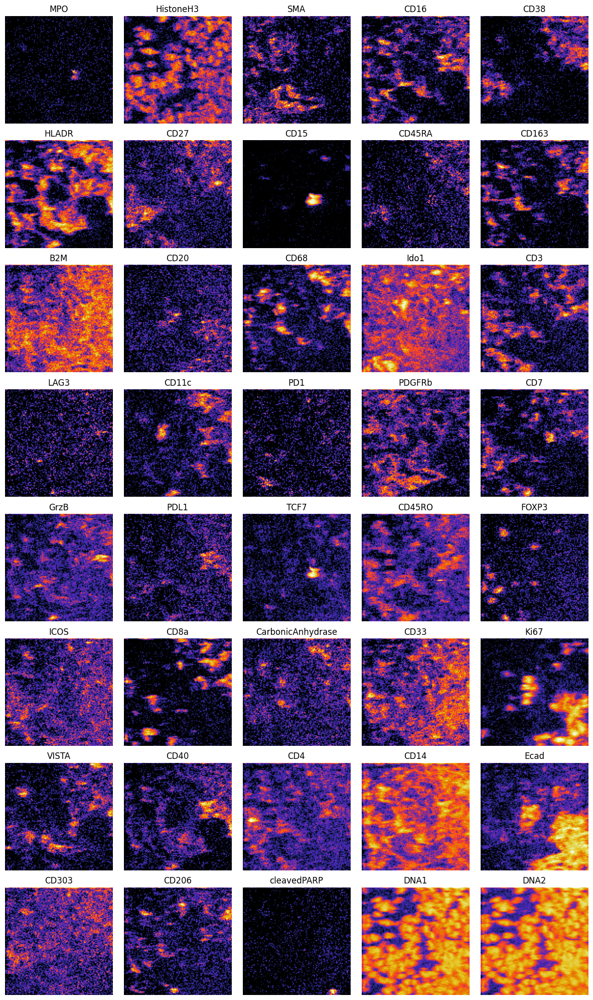

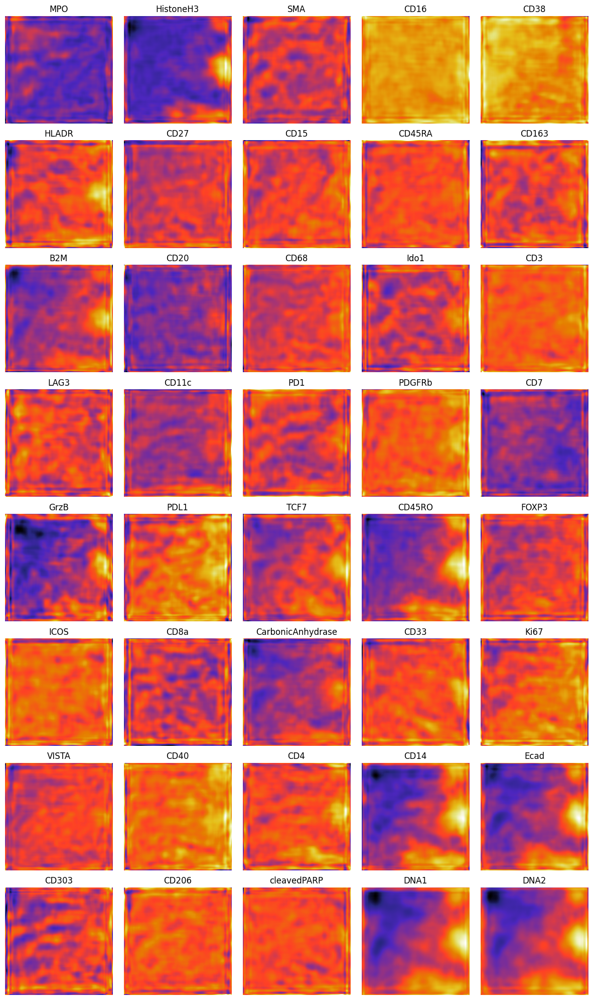

In [10]:
test_img, test_channel_ids = test_dataset[16]
test_img = test_img.to(torch.float32).to(device)
test_channel_ids = test_channel_ids.to(device)

test_img = test_img.unsqueeze(0)
test_channel_ids = test_channel_ids.unsqueeze(0)

with torch.no_grad():
    output, _ = model(test_img, test_channel_ids)

plot_markers(test_img.squeeze().cpu().numpy(), markers_names_map)
plot_markers(output.squeeze().cpu().numpy(), markers_names_map)

#### Only one channel

In [8]:
device = 'cuda' if torch.cuda.is_available() else 'mps'

encoder_layers_blocks = [1, 1, 1]
encoder_embedding_dims = [64, 128, 256]
channel_embedding_dim = 48
latent_dim = 1024
decoder_layers_blocks = [1, 1, 1]
decoder_embedding_dims = [256, 128, 64]


model = MultiplexImageTransformer(
    channel_embedding_dim=channel_embedding_dim,
    num_channels=40,
    encoder_layers_blocks=encoder_layers_blocks,
    encoder_embedding_dims=encoder_embedding_dims,
    latent_dim=latent_dim,
    decoder_embedding_dims=decoder_embedding_dims,
    decoder_layer_blocks=decoder_layers_blocks,
    input_shape=SIZE
).to(device)

In [9]:
lr = 2e-4
weight_decay = 0.001
gradient_accumulation_steps = 1
epochs = 20
optimizer = optim.AdamW(model.parameters(), lr=lr, weight_decay=weight_decay)

frac_channels = 1/40

train(model, optimizer, train_dataloader, val_dataloader, device, epochs=epochs, gradient_accumulation_steps=gradient_accumulation_steps, frac_channels=frac_channels)

100%|██████████| 100/100 [00:38<00:00,  2.62it/s]


Epoch 0 loss: 0.29590491456910967
Validation loss: 73.59941947937011


100%|██████████| 100/100 [00:37<00:00,  2.69it/s]


Epoch 1 loss: 0.15404545783996582
Validation loss: 16.225312514305116


100%|██████████| 100/100 [00:37<00:00,  2.66it/s]


Epoch 2 loss: 0.12531014480628072
Validation loss: 1.465551644563675


100%|██████████| 100/100 [00:37<00:00,  2.67it/s]


Epoch 3 loss: 0.05238531657494604
Validation loss: 0.8164749282598496


100%|██████████| 100/100 [00:37<00:00,  2.69it/s]


Epoch 4 loss: 0.03588922249153256
Validation loss: 0.3470192368328571


100%|██████████| 100/100 [00:37<00:00,  2.70it/s]


Epoch 5 loss: 0.04282341363374144
Validation loss: 0.29695886343717576


100%|██████████| 100/100 [00:36<00:00,  2.72it/s]


Epoch 6 loss: 0.03796323167160153
Validation loss: 0.1163577875494957


100%|██████████| 100/100 [00:36<00:00,  2.73it/s]


Epoch 7 loss: 0.03265242184977978
Validation loss: 0.12090716145932674


100%|██████████| 100/100 [00:37<00:00,  2.70it/s]


Epoch 8 loss: 0.03285456180339679
Validation loss: 0.12190381683409214


100%|██████████| 100/100 [00:36<00:00,  2.74it/s]


Epoch 9 loss: 0.03226079400163144
Validation loss: 0.09861340112984181


100%|██████████| 100/100 [00:36<00:00,  2.73it/s]


Epoch 10 loss: 0.0346330386842601
Validation loss: 0.04531053081154823


100%|██████████| 100/100 [00:36<00:00,  2.75it/s]


Epoch 11 loss: 0.028323389797005803
Validation loss: 0.11241947561502456


100%|██████████| 100/100 [00:36<00:00,  2.74it/s]


Epoch 12 loss: 0.025506663555279373
Validation loss: 0.055878977552056314


100%|██████████| 100/100 [00:36<00:00,  2.74it/s]


Epoch 13 loss: 0.031174027102533728
Validation loss: 0.0450176914781332


100%|██████████| 100/100 [00:36<00:00,  2.75it/s]


Epoch 14 loss: 0.023323239870369435
Validation loss: 0.08407254688441754


100%|██████████| 100/100 [00:36<00:00,  2.74it/s]


Epoch 15 loss: 0.02514974440680817
Validation loss: 0.043449347689747814


100%|██████████| 100/100 [00:36<00:00,  2.74it/s]


Epoch 16 loss: 0.025008340363856404
Validation loss: 0.052305808365345


100%|██████████| 100/100 [00:36<00:00,  2.71it/s]


Epoch 17 loss: 0.03597643555491231
Validation loss: 0.9879247266054153


100%|██████████| 100/100 [00:36<00:00,  2.73it/s]


Epoch 18 loss: 0.04287774905213155
Validation loss: 0.16712545089423655


100%|██████████| 100/100 [00:36<00:00,  2.75it/s]


Epoch 19 loss: 0.03541881723795086
Validation loss: 0.9627331015467644


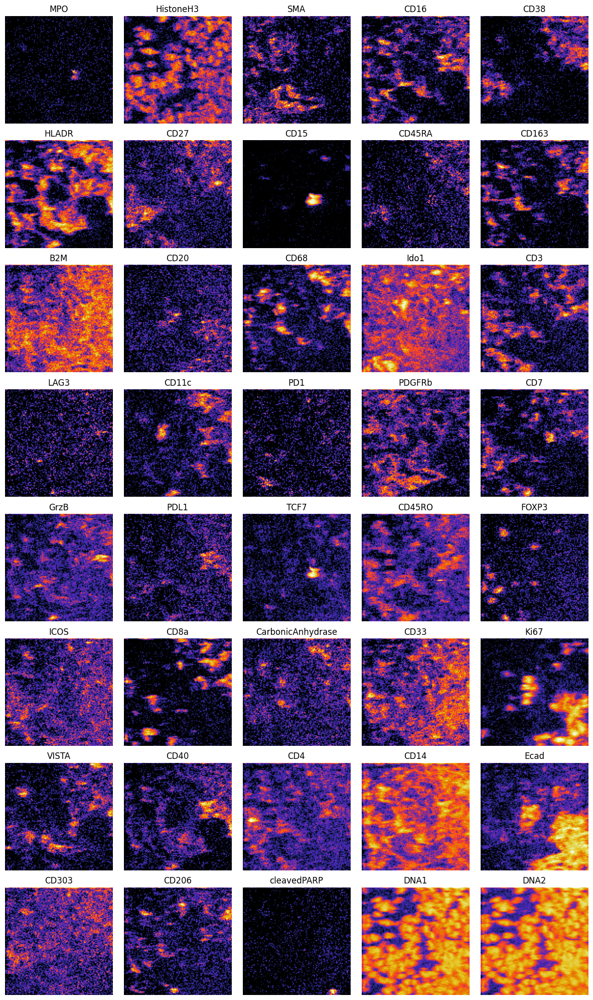

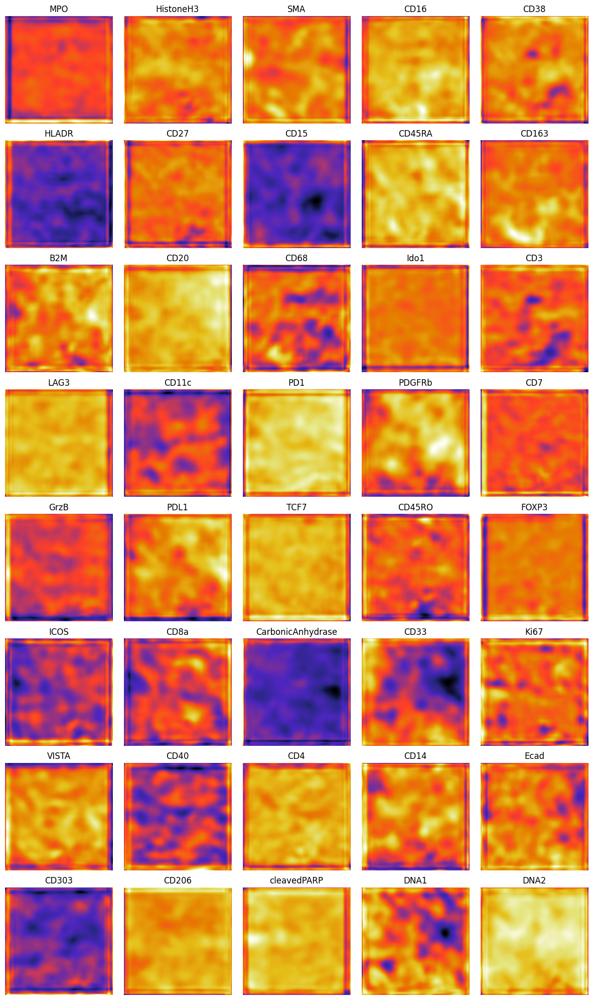

In [10]:
test_img, test_channel_ids = test_dataset[16]
test_img = test_img.to(torch.float32).to(device)
test_channel_ids = test_channel_ids.to(device)

test_img = test_img.unsqueeze(0)
test_channel_ids = test_channel_ids.unsqueeze(0)

outputs = []
with torch.no_grad():
    for i in range(40):
        output, _ = model(test_img[:, i:i+1], test_channel_ids[:, i:i+1])
        outputs.append(output.cpu())
outputs = torch.cat(outputs, dim=1)

plot_markers(test_img.squeeze().cpu().numpy(), markers_names_map)
plot_markers(outputs.squeeze().cpu().numpy(), markers_names_map)

#### Fixed one channel (Ecad)

In [8]:
def train_fixed(model, optimizer, train_dataloader, val_dataloader, device, epochs=10, gradient_accumulation_steps=1, idx_channel=34):
    model.train()
    criterion = nn.MSELoss()
    for epoch in range(epochs):
        model.train()
        running_loss = 0.0
        for i, (img, channel_ids) in enumerate(tqdm(train_dataloader)):
            img = img.to(torch.float32).to(device)
             
            input_masked_img = img[:, idx_channel:idx_channel+1, :, :]
            # used_channels_ids = used_channels_ids.unsqueeze(0).repeat(img.shape[0], 1)

            output, _ = model(input_masked_img, idx_channel)
            # chosen_channel_reconstruction = output[:, used_channels_ids[0]]
            
            loss = criterion(output, input_masked_img)
            loss.backward()
            if (i+1) % gradient_accumulation_steps == 0:
                optimizer.step()
                optimizer.zero_grad()
            running_loss += loss.item()
                        
        print(f'Epoch {epoch} loss: {running_loss / len(train_dataloader)}')
        val_loss = test_fixed(model, val_dataloader, device, idx_channel=idx_channel)
        print(f'Validation loss: {val_loss}')

def test_fixed(model, test_dataloader, device, idx_channel=34):
    model.eval()
    criterion = nn.MSELoss()
    running_loss = 0.0
    with torch.no_grad():
        for img, channel_ids in test_dataloader:
            img = img[:, idx_channel:idx_channel+1, :, :]
            img = img.to(torch.float32).to(device)
            channel_ids = channel_ids.to(device)
            output, _ = model(img, channel_ids)
            loss = criterion(output, img)
            running_loss += loss.item()
    return running_loss / len(test_dataloader)

In [9]:
device = 'cuda' if torch.cuda.is_available() else 'mps'

encoder_layers_blocks = [1, 1, 1]
encoder_embedding_dims = [64, 128, 256]
channel_embedding_dim = 32
latent_dim = 1024
decoder_layers_blocks = [1, 1, 1]
decoder_embedding_dims = [256, 128, 64]


model = MultiplexImageTransformerFixed(
    channel_embedding_dim=channel_embedding_dim,
    num_channels=1,
    encoder_layers_blocks=encoder_layers_blocks,
    encoder_embedding_dims=encoder_embedding_dims,
    latent_dim=latent_dim,
    decoder_embedding_dims=decoder_embedding_dims,
    decoder_layer_blocks=decoder_layers_blocks,
    input_shape=SIZE
).to(device)

In [10]:
lr = 2e-4
weight_decay = 0.001
gradient_accumulation_steps = 1
epochs = 20
optimizer = optim.AdamW(model.parameters(), lr=lr, weight_decay=weight_decay)

train_fixed(model, optimizer, train_dataloader, val_dataloader, device, epochs=epochs, gradient_accumulation_steps=gradient_accumulation_steps)

100%|██████████| 9/9 [00:33<00:00,  3.69s/it]


Epoch 0 loss: 0.2296761539247301
Validation loss: 0.059695212791363396


100%|██████████| 9/9 [00:29<00:00,  3.30s/it]


Epoch 1 loss: 0.04543099428216616
Validation loss: 0.04470701515674591


100%|██████████| 9/9 [00:30<00:00,  3.38s/it]


Epoch 2 loss: 0.033768930161992707
Validation loss: 0.04145975783467293


100%|██████████| 9/9 [00:30<00:00,  3.44s/it]


Epoch 3 loss: 0.030819550570514467
Validation loss: 0.04117245227098465


100%|██████████| 9/9 [00:30<00:00,  3.41s/it]


Epoch 4 loss: 0.031197556604941685
Validation loss: 0.03970874287188053


100%|██████████| 9/9 [00:30<00:00,  3.39s/it]


Epoch 5 loss: 0.03229027883046203
Validation loss: 0.03928715238968531


100%|██████████| 9/9 [00:30<00:00,  3.37s/it]


Epoch 6 loss: 0.029963706723517843
Validation loss: 0.03903214323023955


100%|██████████| 9/9 [00:30<00:00,  3.36s/it]


Epoch 7 loss: 0.028667020094063547
Validation loss: 0.03847698991497358


100%|██████████| 9/9 [00:30<00:00,  3.38s/it]


Epoch 8 loss: 0.026651817477411695
Validation loss: 0.037283435463905334


100%|██████████| 9/9 [00:30<00:00,  3.40s/it]


Epoch 9 loss: 0.028893345553014014
Validation loss: 0.03527740699549516


100%|██████████| 9/9 [00:30<00:00,  3.36s/it]


Epoch 10 loss: 0.027791192548142538
Validation loss: 0.03384285792708397


100%|██████████| 9/9 [00:30<00:00,  3.42s/it]


Epoch 11 loss: 0.024772108635968633
Validation loss: 0.03303751473625501


100%|██████████| 9/9 [00:30<00:00,  3.40s/it]


Epoch 12 loss: 0.027602135721180174
Validation loss: 0.03211777160565058


100%|██████████| 9/9 [00:30<00:00,  3.44s/it]


Epoch 13 loss: 0.02544827779961957
Validation loss: 0.030305569991469383


100%|██████████| 9/9 [00:30<00:00,  3.35s/it]


Epoch 14 loss: 0.022635057361589536
Validation loss: 0.030131741737325985


100%|██████████| 9/9 [00:30<00:00,  3.41s/it]


Epoch 15 loss: 0.022530267015099525
Validation loss: 0.02950929601987203


100%|██████████| 9/9 [00:30<00:00,  3.43s/it]


Epoch 16 loss: 0.021376552681128185
Validation loss: 0.029276733597119648


100%|██████████| 9/9 [00:30<00:00,  3.36s/it]


Epoch 17 loss: 0.020729656020800274
Validation loss: 0.028756452724337578


100%|██████████| 9/9 [00:29<00:00,  3.31s/it]


Epoch 18 loss: 0.024087272998359468
Validation loss: 0.028593408564726513


100%|██████████| 9/9 [00:29<00:00,  3.31s/it]


Epoch 19 loss: 0.021971983628140554
Validation loss: 0.028697660192847252


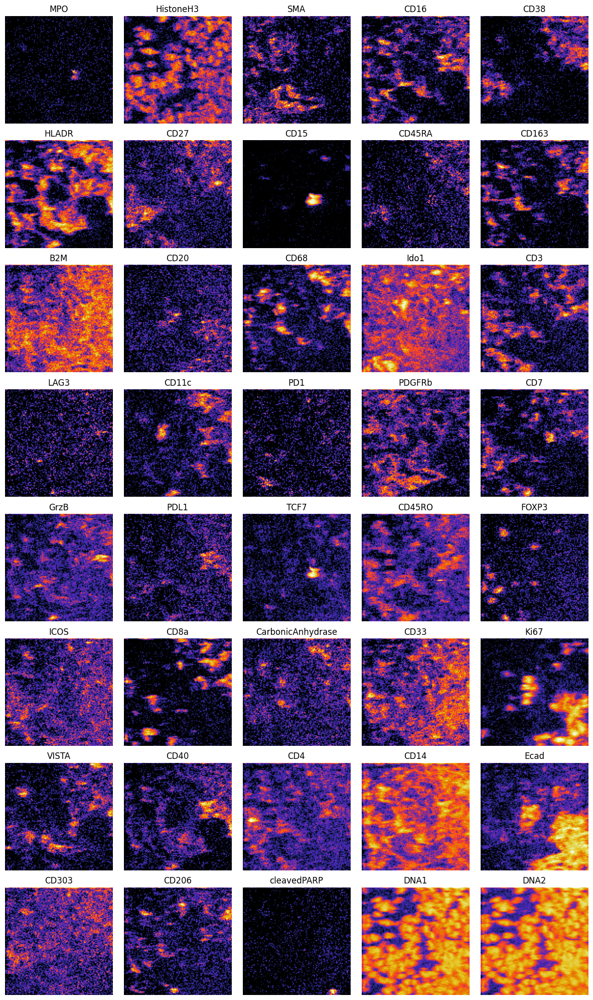

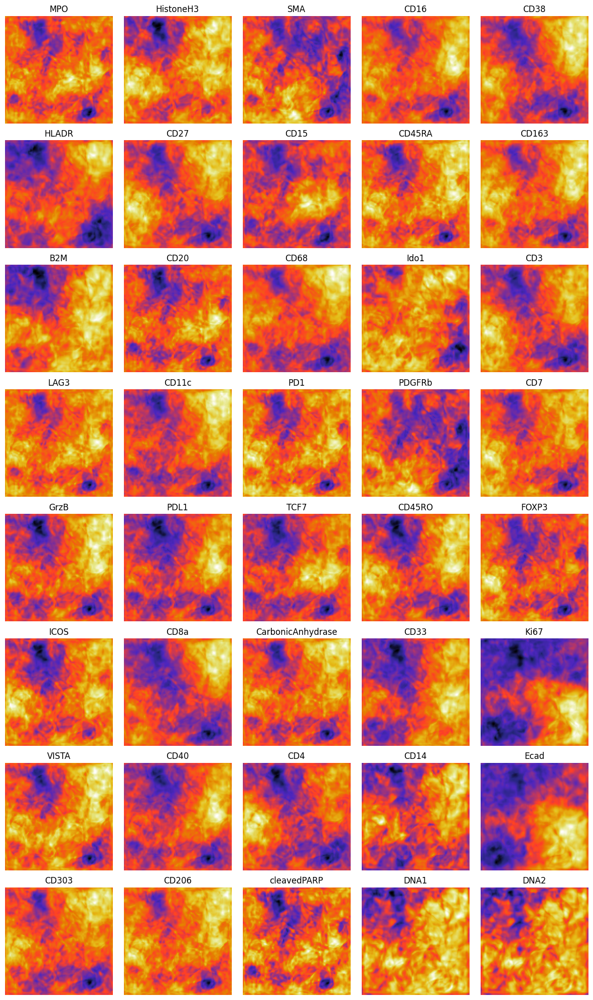

In [11]:
test_img, test_channel_ids = test_dataset[16]
test_img = test_img.to(torch.float32).to(device)
test_channel_ids = test_channel_ids.to(device)

test_img = test_img.unsqueeze(0)
test_channel_ids = test_channel_ids.unsqueeze(0)

outputs = []
with torch.no_grad():
    for i in range(40):
        output, _ = model(test_img[:, i:i+1], test_channel_ids[:, i:i+1])
        outputs.append(output.cpu())
outputs = torch.cat(outputs, dim=1)

plot_markers(test_img.squeeze().cpu().numpy(), markers_names_map)
plot_markers(outputs.squeeze().cpu().numpy(), markers_names_map)

In [12]:
# Assymetric fixed

device = 'cuda' if torch.cuda.is_available() else 'mps'

encoder_layers_blocks = [1, 1, 1]
encoder_embedding_dims = [64, 128, 256]

channel_embedding_dim = 48
latent_dim = 1024

decoder_blocks = 3
decoder_embedding_dim = 256

model = MultiplexImageTransformerFixedAssymetric(
    channel_embedding_dim=channel_embedding_dim,
    num_channels=1,
    encoder_layers_blocks=encoder_layers_blocks,
    encoder_embedding_dims=encoder_embedding_dims,
    latent_dim=latent_dim,
    decoder_blocks=decoder_blocks,
    decoder_embedding_dim=decoder_embedding_dim,
    input_shape=SIZE
).to(device)

In [13]:
lr = 2e-4
weight_decay = 0.001
gradient_accumulation_steps = 1
epochs = 20
optimizer = optim.AdamW(model.parameters(), lr=lr, weight_decay=weight_decay)

train_fixed(model, optimizer, train_dataloader, val_dataloader, device, epochs=epochs, gradient_accumulation_steps=gradient_accumulation_steps)

100%|██████████| 9/9 [00:29<00:00,  3.24s/it]


Epoch 0 loss: 0.3444567488299476
Validation loss: 0.2828763425350189


100%|██████████| 9/9 [00:28<00:00,  3.19s/it]


Epoch 1 loss: 0.16977592640452915
Validation loss: 0.1318544497092565


100%|██████████| 9/9 [00:28<00:00,  3.20s/it]


Epoch 2 loss: 0.10730939772393969
Validation loss: 0.09866611907879512


100%|██████████| 9/9 [00:29<00:00,  3.27s/it]


Epoch 3 loss: 0.08002119014660518
Validation loss: 0.07965068519115448


100%|██████████| 9/9 [00:29<00:00,  3.27s/it]


Epoch 4 loss: 0.0671767753859361
Validation loss: 0.07023602724075317


100%|██████████| 9/9 [00:29<00:00,  3.26s/it]


Epoch 5 loss: 0.06072325383623441
Validation loss: 0.06104562307397524


100%|██████████| 9/9 [00:29<00:00,  3.27s/it]


Epoch 6 loss: 0.05399173125624657
Validation loss: 0.05771978199481964


100%|██████████| 9/9 [00:29<00:00,  3.27s/it]


Epoch 7 loss: 0.048187828726238675
Validation loss: 0.05231717477242152


100%|██████████| 9/9 [00:29<00:00,  3.24s/it]


Epoch 8 loss: 0.04511577760179838
Validation loss: 0.05170696477095286


100%|██████████| 9/9 [00:29<00:00,  3.25s/it]


Epoch 9 loss: 0.04334638805852996
Validation loss: 0.05035717785358429


100%|██████████| 9/9 [00:29<00:00,  3.27s/it]


Epoch 10 loss: 0.04092959273192617
Validation loss: 0.04939460630218188


100%|██████████| 9/9 [00:29<00:00,  3.26s/it]


Epoch 11 loss: 0.038413159963157445
Validation loss: 0.043091630563139915


100%|██████████| 9/9 [00:29<00:00,  3.25s/it]


Epoch 12 loss: 0.034191451552841395
Validation loss: 0.042052206272880234


100%|██████████| 9/9 [00:29<00:00,  3.25s/it]


Epoch 13 loss: 0.033372240141034126
Validation loss: 0.0396782166014115


100%|██████████| 9/9 [00:28<00:00,  3.22s/it]


Epoch 14 loss: 0.03350263854695691
Validation loss: 0.038907542203863464


100%|██████████| 9/9 [00:28<00:00,  3.22s/it]


Epoch 15 loss: 0.03316130013101631
Validation loss: 0.038100252548853554


100%|██████████| 9/9 [00:29<00:00,  3.23s/it]


Epoch 16 loss: 0.030445818478862446
Validation loss: 0.0386578639348348


100%|██████████| 9/9 [00:28<00:00,  3.17s/it]


Epoch 17 loss: 0.032559408702784114
Validation loss: 0.035642256339391075


100%|██████████| 9/9 [00:28<00:00,  3.15s/it]


Epoch 18 loss: 0.029584715970688395
Validation loss: 0.03510778956115246


100%|██████████| 9/9 [00:28<00:00,  3.18s/it]


Epoch 19 loss: 0.030330600837866466
Validation loss: 0.034196117892861366


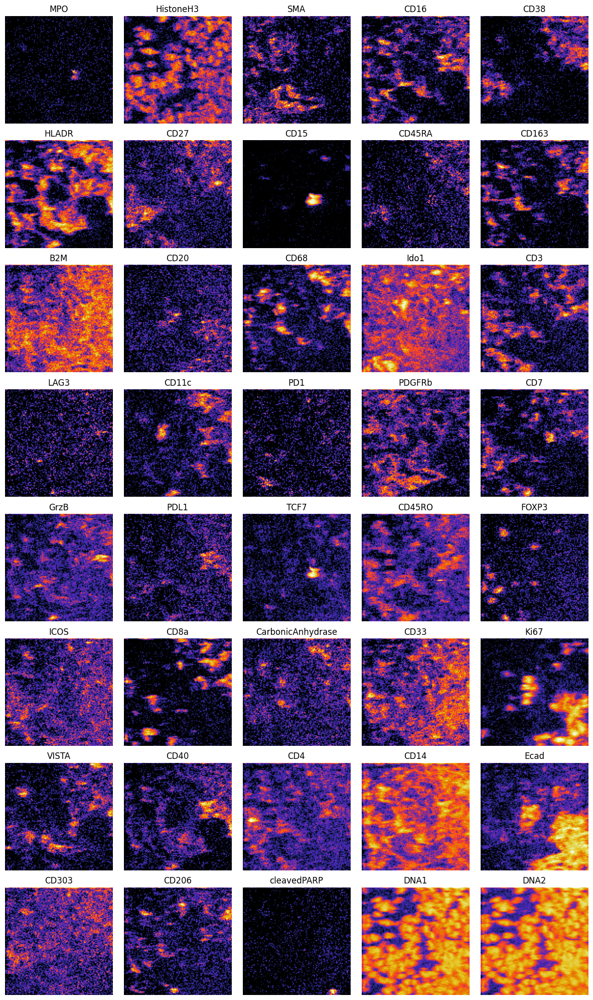

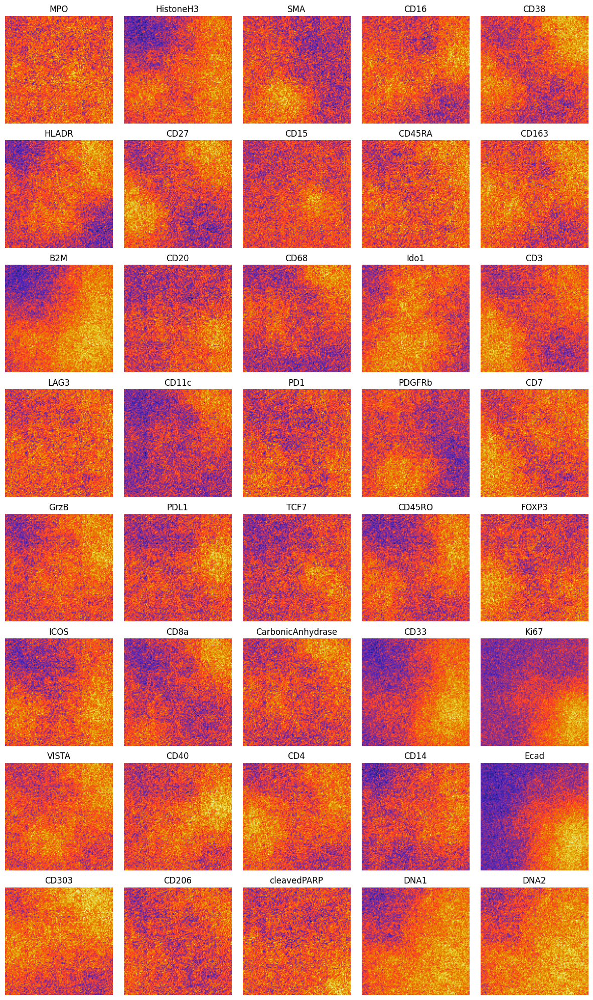

In [14]:
test_img, test_channel_ids = test_dataset[16]
test_img = test_img.to(torch.float32).to(device)
test_channel_ids = test_channel_ids.to(device)

test_img = test_img.unsqueeze(0)
test_channel_ids = test_channel_ids.unsqueeze(0)

outputs = []
with torch.no_grad():
    for i in range(40):
        output, _ = model(test_img[:, i:i+1], test_channel_ids[:, i:i+1])
        outputs.append(output.cpu())
outputs = torch.cat(outputs, dim=1)

plot_markers(test_img.squeeze().cpu().numpy(), markers_names_map)
plot_markers(outputs.squeeze().cpu().numpy(), markers_names_map)

In [10]:
# masked autoencoder training

# seed everything
torch.manual_seed(42)
torch.cuda.manual_seed(42)
torch.cuda.manual_seed_all(42)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
np.random.seed(42)


def train_masked(model, optimizer, train_dataloader, val_dataloader, device, epochs=10, gradient_accumulation_steps=1):
    model.train()
    criterion = nn.MSELoss()
    for epoch in range(epochs):
        model.train()
        running_loss = 0.0
        for i, (img, channel_ids) in enumerate(tqdm(train_dataloader)):
            img = img.to(torch.float32).to(device)
            # channel_ids = channel_ids.to(device)

            masked_channels_ids = np.random.choice(channel_ids[0], int(channel_ids.shape[1] * 0.5), replace=False)

            avail_channels_ids = torch.tensor([i for i in channel_ids[0] if i not in masked_channels_ids]).to(device)
            masked_channels_ids = torch.tensor(masked_channels_ids).to(device)

            input_masked_img = img[:, avail_channels_ids]
            true_masked_img = img[:, masked_channels_ids]

            avail_channels_ids = avail_channels_ids.unsqueeze(0).repeat(img.shape[0], 1)

            output, _ = model(input_masked_img, avail_channels_ids)
            output_masked = output[:, masked_channels_ids]

            loss = criterion(output_masked, true_masked_img)
            loss.backward()
            if (i+1) % gradient_accumulation_steps == 0:
                optimizer.step()
                optimizer.zero_grad()
            running_loss += loss.item()
                        
        print(f'Epoch {epoch} loss: {running_loss / len(train_dataloader)}')
        val_loss = test_masked(model, val_dataloader, device)
        print(f'Validation loss: {val_loss}')

def test_masked(model, test_dataloader, device):
    model.eval()
    criterion = nn.MSELoss()
    running_loss = 0.0
    with torch.no_grad():
        for img, channel_ids in test_dataloader:
            img = img.to(torch.float32).to(device)
            # channel_ids = channel_ids.to(device)
            masked_channels_ids = np.random.choice(channel_ids[0], int(channel_ids.shape[1] * 0.5), replace=False)
            avail_channels_ids = torch.tensor([i for i in channel_ids[0] if i not in masked_channels_ids]).to(device)
            masked_channels_ids = torch.tensor(masked_channels_ids).to(device)
            
            input_masked_img = img[:, avail_channels_ids]
            true_masked_img = img[:, masked_channels_ids]

            avail_channels_ids = avail_channels_ids.unsqueeze(0).repeat(img.shape[0], 1)

            output, _ = model(input_masked_img, avail_channels_ids)
            output_masked = output[:, masked_channels_ids]

            loss = criterion(output_masked, true_masked_img)
            running_loss += loss.item()
    return running_loss / len(test_dataloader)

In [11]:
device = 'cuda' if torch.cuda.is_available() else 'mps'

encoder_layers_blocks = [3, 3, 3]
encoder_embedding_dims = [96, 192, 384]
# encoder_num_heads = [6, 6, 6]

decoder_dim = 192
decoder_blocks_num = 3
# decoder_num_heads = 6

# latent_dim = 384

model = MultiplexImageTransformer(
    channel_embedding_dim=96,
    num_channels=40,
    encoder_layers_blocks=encoder_layers_blocks,
    encoder_embedding_dims=encoder_embedding_dims,
    decoder_dim=decoder_dim,
    decoder_blocks_num=decoder_blocks_num,

).to(device)

In [ ]:
import json 
import matplotlib.pyplot as plt

tokenizer_vocab = json.load(open('tokenizer_vocab.json'))

mask_channel_names = [
    'DNA1',
    'DNA2',
    'Ecad',
    'Ido1',
    'CD3',
    'HLADR',
    'CD15'
]

mask_channel_ids = [tokenizer_vocab[name] for name in mask_channel_names]

test_img, test_channel_ids = test_dataset[16]
test_img = test_img.to(torch.float32).to(device)
test_channel_ids = test_channel_ids.to(device)

avail_channels_ids = torch.tensor([i for i in test_channel_ids if i not in mask_channel_ids]).to(device)


test_img = test_img.unsqueeze(0)

input_masked_img = test_img[:, avail_channels_ids]
test_channel_ids = avail_channels_ids.unsqueeze(0)

with torch.no_grad():
    output, _ = model(input_masked_img, test_channel_ids)

# plot_markers(test_img.squeeze().cpu().numpy(), markers_names_map)
# plot_markers(output.squeeze().cpu().numpy(), markers_names_map)

fig, axs = plt.subplots(40, 2)
fig.set_size_inches(8, 100)
for i in range(40):
    axs[i, 0].imshow(test_img.squeeze().cpu().numpy()[i], cmap='CMRmap')
    axs[i, 1].imshow(output.squeeze().cpu().numpy()[i], cmap='CMRmap')
    axs[i, 0].axis('off')
    axs[i, 1].axis('off')
    axs[i, 0].set_title(markers_names_map[i])
    axs[i, 1].set_title(markers_names_map[i])

plt.tight_layout()
plt.show()